In [127]:
import numpy as np
import pandas as pd
import vectorbt as vbt
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas_ta as ta
import yfinance as yf 
import warnings
import plotly.graph_objects as go
from plotly.subplots import make_subplots
warnings.filterwarnings('ignore')
plt.style.use('ggplot')
%matplotlib inline

### Load Data

In [2]:
# BTC Full
btc = pd.read_csv('2022.2.9BTCUSDT-H1-NoSession.csv')
btc.Date = btc.Date.astype(str)+' '+ btc.Time
btc.Date = pd.to_datetime(btc.Date)
btc.drop(columns= ['Time'], inplace = True)
btc = btc.set_index('Date')

In [126]:
# EURUSD Full
df = pd.read_csv('2022.2.9EURUSD-H4-NoSession.csv')
df.Date = df.Date.astype(str)+' '+ df.Time
df.Date = pd.to_datetime(df.Date)
df.drop(columns= ['Time'], inplace = True)
df = df.set_index('Date')

##### Trend, Non-Trend Data

In [4]:
dftr1 = pd.read_csv('TRE_EURUSD_2011_2015.csv', index_col = 'Date')
dftr2 = pd.read_csv('TRE_EURUSD_2017_2018.csv', index_col = 'Date')
# ------------------------------------------------------------------
dfsw1 = pd.read_csv('SW_EURUSD_2015_2017_4H.csv', index_col = 'Date')
dfsw2 = pd.read_csv('SW_EURUSD_2010_2014_4H.csv', index_col = 'Date')

### Util Function

In [5]:
#initial
def set_up_df(df:pd.DataFrame , index):  
    df1    =   pd.DataFrame(columns=index)
    df1['date']  =    df.index 
    df1.date = pd.to_datetime(df1.date,format='%Y-%m-%d')
    df1 = df1.set_index('date')
    return df1

#for calculate duration
def convert_to_hours(delta):
    total_seconds = delta.total_seconds()
    hours = str(int(total_seconds // 3600))
    return hours

#Performance Matric
def cal_consecutive(df:pd.DataFrame):
    df['win']= np.sign(df) # assign sign on log
    blocks = df['win'].ne(df['win'].shift()).cumsum() 
    df['consecutive_WL'] = df['win'].groupby(blocks).cumsum()
    return df['consecutive_WL'] 

def Cal_portstat(port):
    port_return = port.total_return().to_frame()
    port_return['MaxDD'] = port.max_drawdown()
    port_return['NumTrade'] = port.trades.count()
    port_return['WinRate'] = port.trades.win_rate()
    port_return['AvgWinningTrade'] = port.trades.winning.returns.mean()
    port_return['AvgLosingTrade'] = port.trades.losing.returns.mean()
    port_return['SharpRatio'] = port.returns_acc.sharpe_ratio()
    return port_return

def Cal_pip(df):
    pip = []
    pipp = df['Avg Exit Price'] - df['Avg Entry Price']
    for i in portfinal['Direction']:
        if i == 'Long':
            pip.append(1)
        else :
            pip.append(-1)    
    return (pip * pipp) 

def Cal_mae_mfe(data,port):
    MAE = []
    MFE = []
    for i,j,y,k in zip(port['Entry Timestamp'], port['Exit Timestamp'], port['Avg Entry Price'], port['Direction']):
        if k == 'Long':
            MFE.append((data.loc[i:j]['High'].max() - y)/y)
            MAE.append((y - df.loc[i:j]['Low'].min())/y)
        else :
            MAE.append((data.loc[i:j]['High'].max() - y)/y)
            MFE.append((y - df.loc[i:j]['Low'].min())/y)
    return MAE, MFE  

def Calkelly(port):
    init_cash = 10000
    W = port.stats()[15]/100
    A = abs(port.stats()[19])
    B = port.stats()[18]
    Percent_kelly = (W/A) - ((1-W)/B)
    riskpertrade = Percent_kelly * init_cash
    print(f'Percent_kelly = {Percent_kelly}')


### Define Strategy Function

In [8]:
help(ta.fisher)

Help on function fisher in module pandas_ta.momentum.fisher:

fisher(high, low, length=None, signal=None, offset=None, **kwargs)
    Fisher Transform (FISHT)
    
    Attempts to identify significant price reversals by normalizing prices over a
    user-specified number of periods. A reversal signal is suggested when the the
    two lines cross.
    
    Sources:
        TradingView (Correlation >99%)
    
    Calculation:
        Default Inputs:
            length=9, signal=1
        HL2 = hl2(high, low)
        HHL2 = HL2.rolling(length).max()
        LHL2 = HL2.rolling(length).min()
    
        HLR = HHL2 - LHL2
        HLR[HLR < 0.001] = 0.001
    
        position = ((HL2 - LHL2) / HLR) - 0.5
    
        v = 0
        m = high.size
        FISHER = [npNaN for _ in range(0, length - 1)] + [0]
        for i in range(length, m):
            v = 0.66 * position[i] + 0.67 * v
            if v < -0.99: v = -0.999
            if v >  0.99: v =  0.999
            FISHER.append(0.5 * (np

In [54]:
def strategy(df, length= 9):
    df['f1'] = df.ta.fisher(length)[f"FISHERT_{length}_1"]
    df['f2'] = df.ta.fisher(length)[f"FISHERTs_{length}_1"]

    l1 = (df['f1'] > df['f2']) 
    l2 = (df['f1'] < (-1.45))
    df['long_signal'] = l1 & l2

    s1 = (df['f1'] < df['f2'])
    s2 = (df['f1'] > (1.45))
    df['short_signal'] = s1 & s2

    df['long_exit'] = s1 & s2
    df['short_exit'] = l1 & l2

    return df

------------------------------------------------------------------

### Backtest Strategy

#### Default Strategy

In [35]:
def run_strategy(df, timeframe = '1h', cash = 10000):
    df = strategy(df)
    port = vbt.Portfolio.from_signals(df.Close,
                                    entries = df['long_signal'],
                                    exits = df['long_exit'],
                                    short_entries = df['short_signal'],
                                    short_exits = df['short_exit'],
                                    freq = timeframe,
                                    init_cash = cash,
                                    fees = 0.00,
                                    slippage = 0.00)
    return port

In [36]:
run_strategy(df).stats()

Start                               2003-05-05 00:00:00
End                                 2022-02-07 20:00:00
Period                               1262 days 00:00:00
Start Value                                     10000.0
End Value                                  16991.713502
Total Return [%]                              69.917135
Benchmark Return [%]                           2.004244
Max Gross Exposure [%]                            100.0
Total Fees Paid                                     0.0
Max Drawdown [%]                              29.872586
Max Drawdown Duration                 206 days 11:00:00
Total Trades                                        947
Total Closed Trades                                 946
Total Open Trades                                     1
Open Trade PnL                              -289.015462
Win Rate [%]                                  64.799154
Best Trade [%]                                 4.881467
Worst Trade [%]                               -8

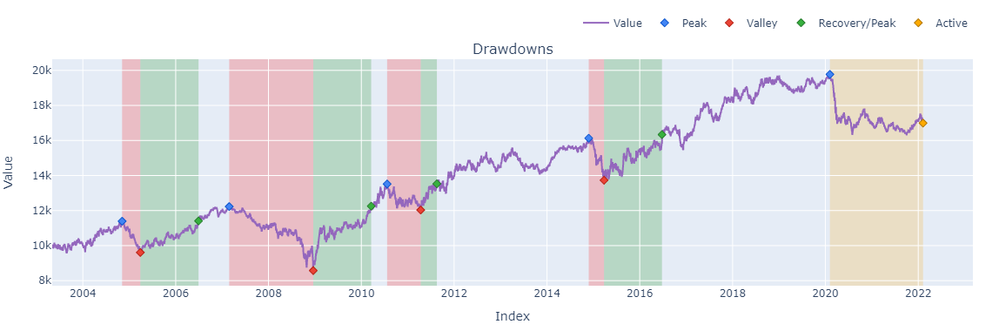

In [27]:
run_strategy(df).plot(subplots=['drawdowns']).show() # Equity Curve

----------------------------------------

### Add Stop Loss

In [38]:
def run_strategy_sl(df, timeframe = '1h', cash = 10000, multiply = 1):
    df = strategy(df)
    df['vol'] = df.ta.stdev().ewm(alpha=0.96).mean()
    df['sl_stop'] = (df['vol'] * multiply) / df.Close
    
    port = vbt.Portfolio.from_signals(df.Close,
                                    entries = df['long_signal'],
                                    exits = df['long_exit'] ,
                                    short_entries = df['short_signal'],
                                    short_exits = df['short_exit'],
                                    freq = timeframe,
                                    init_cash = cash,
                                    fees = 0.00, sl_stop = df['sl_stop'],
                                    slippage = 0.00)
    return port

# Optimise ATR Multiply
portstats = []
start, end, step = (0.1, 4, 0.1)
array = np.arange(start,end,step)
for i in array:
    port = run_strategy_sl(df, multiply = i)
    portstats.append(port.stats())
pd.DataFrame(portstats).sort_values('Sharpe Ratio',ascending=False).head(5)     # Sort for best param

,Start,End,Period,Start Value,End Value,Total Return [%],Benchmark Return [%],Max Gross Exposure [%],Total Fees Paid,Max Drawdown [%],...,Avg Winning Trade [%],Avg Losing Trade [%],Avg Winning Trade Duration,Avg Losing Trade Duration,Profit Factor,Expectancy,Sharpe Ratio,Calmar Ratio,Omega Ratio,Sortino Ratio
12,2003-05-05,2022-02-07 20:00:00,1262 days,10000.0,21554.497076,115.544971,2.004244,100.0,0.0,19.935589,...,0.790722,-0.703761,0 days 18:23:00.582524271,0 days 12:33:40.817843866,1.120605,7.006076,1.204695,1.247646,1.044075,1.744052
11,2003-05-05,2022-02-07 20:00:00,1262 days,10000.0,20790.834511,107.908345,2.004244,100.0,0.0,20.009032,...,0.791980,-0.679719,0 days 18:11:59.123020706,0 days 11:47:20.524433849,1.116866,6.429249,1.161162,1.178295,1.042832,1.680408
15,2003-05-05,2022-02-07 20:00:00,1262 days,10000.0,21040.260139,110.402601,2.004244,100.0,0.0,22.744639,...,0.778034,-0.786262,0 days 19:13:52.472324723,0 days 15:05:33.808844507,1.119312,7.290899,1.150006,1.055348,1.041384,1.661304
16,2003-05-05,2022-02-07 20:00:00,1262 days,10000.0,20989.232807,109.892328,2.004244,100.0,0.0,20.542180,...,0.774571,-0.817289,0 days 19:24:48.588957055,0 days 15:52:57.414561664,1.118652,7.384004,1.141295,1.164260,1.040873,1.648099
13,2003-05-05,2022-02-07 20:00:00,1262 days,10000.0,20505.404176,105.054042,2.004244,100.0,0.0,22.137569,...,0.783271,-0.730771,0 days 18:40:35.294117647,0 days 13:23:04.615384615,1.115108,6.635257,1.128627,1.042727,1.041055,1.630454


#### Strategy with Volatility SL

In [213]:
def run_strategy_sl(df, timeframe = '1h', cash = 10000, multiply = 1):
    df = strategy(df)
    df['vol'] = df.ta.stdev().ewm(alpha=0.96).mean()
    df['sl_stop'] = (df['vol'] * multiply) / df.Close
    
    port = vbt.Portfolio.from_signals(df.Close,
                                    entries = df['long_signal'],
                                    exits = df['long_exit'] ,
                                    short_entries = df['short_signal'],
                                    short_exits = df['short_exit'],
                                    freq = timeframe,
                                    init_cash = cash,
                                    fees = 0.00, sl_stop = df['sl_stop'],
                                    slippage = 0.00)
    return port

# Optimise ATR Multiply
portstats = []
start, end, step = (0.1, 4, 0.1)
array = np.arange(start,end,step)
for i in array:
    port = run_strategy_sl(btc, multiply = i)
    portstats.append(port.stats())
pd.DataFrame(portstats).sort_values('Sharpe Ratio',ascending=False).head(5)     # Sort for best param

,Start,End,Period,Start Value,End Value,Total Return [%],Benchmark Return [%],Max Gross Exposure [%],Total Fees Paid,Max Drawdown [%],...,Avg Winning Trade [%],Avg Losing Trade [%],Avg Winning Trade Duration,Avg Losing Trade Duration,Profit Factor,Expectancy,Sharpe Ratio,Calmar Ratio,Omega Ratio,Sortino Ratio
36,2017-08-17 04:00:00,2022-02-03,1625 days 15:00:00,10000.0,27715.989495,177.159895,755.879438,100.0,0.0,59.746252,...,3.216638,-1.098789,1 days 08:34:10,0 days 07:24:18.145814581,1.125778,11.096750,0.677961,0.430494,1.032678,1.000128
35,2017-08-17 04:00:00,2022-02-03,1625 days 15:00:00,10000.0,27715.989495,177.159895,755.879438,100.0,0.0,59.746252,...,3.216638,-1.098789,1 days 08:34:10,0 days 07:24:18.145814581,1.125778,11.096750,0.677961,0.430494,1.032678,1.000128
34,2017-08-17 04:00:00,2022-02-03,1625 days 15:00:00,10000.0,27715.989495,177.159895,755.879438,100.0,0.0,59.746252,...,3.216638,-1.098789,1 days 08:34:10,0 days 07:24:18.145814581,1.125778,11.096750,0.677961,0.430494,1.032678,1.000128
33,2017-08-17 04:00:00,2022-02-03,1625 days 15:00:00,10000.0,27715.989495,177.159895,755.879438,100.0,0.0,59.746252,...,3.216638,-1.098789,1 days 08:34:10,0 days 07:24:18.145814581,1.125778,11.096750,0.677961,0.430494,1.032678,1.000128
28,2017-08-17 04:00:00,2022-02-03,1625 days 15:00:00,10000.0,27563.606430,175.636064,755.879438,100.0,0.0,59.746252,...,3.216638,-1.100258,1 days 08:34:10,0 days 07:22:55.135135135,1.125265,11.007242,0.675981,0.427891,1.032591,0.997183


In [40]:
run_strategy_sl(df, multiply = 1.2).stats()

Start                               2003-05-05 00:00:00
End                                 2022-02-07 20:00:00
Period                               1262 days 00:00:00
Start Value                                     10000.0
End Value                                  20790.834511
Total Return [%]                             107.908345
Benchmark Return [%]                           2.004244
Max Gross Exposure [%]                            100.0
Total Fees Paid                                     0.0
Max Drawdown [%]                              20.009032
Max Drawdown Duration                 232 days 21:00:00
Total Trades                                       1662
Total Closed Trades                                1661
Total Open Trades                                     1
Open Trade PnL                                 1.816904
Win Rate [%]                                  49.428055
Best Trade [%]                                 5.016153
Worst Trade [%]                               -2

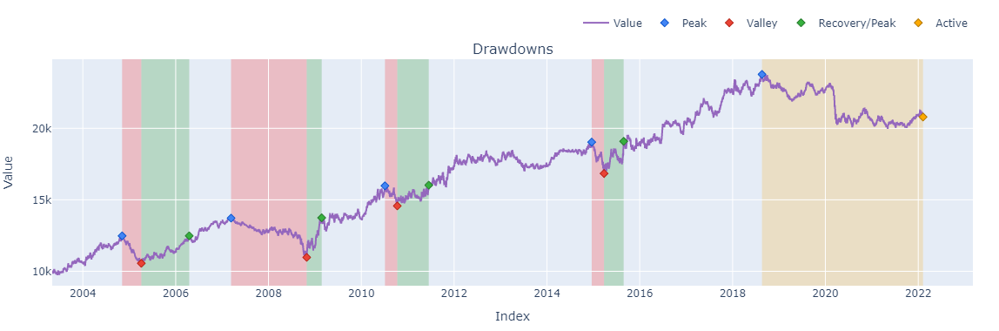

In [41]:
run_strategy_sl(df, multiply = 1.2).plot(subplots=['drawdowns']).show() # Equity Curve

--------------------------------------------------

#### Strategy with Volatility SL (Fix Risk per trade)

In [42]:
#if reach stoploss price it will loss 1% of cash 
def run_strategy_sl_fixRPT(df, timeframe = '1h', cash = 10000, multiply = 1.2, riskpertrade = 0.01):
    df = strategy(df)
    df['vol'] = df.ta.stdev().ewm(alpha=0.96).mean()
    df['sl_stop'] = (df['vol'] * multiply) / df.Close
    df['size'] = ((riskpertrade * cash)/df['sl_stop'])/ df.Close
    port = vbt.Portfolio.from_signals(df.Close,
                                    entries = df['long_signal'],
                                    exits = df['long_exit'] ,
                                    short_entries = df['short_signal'],
                                    short_exits = df['short_exit'],
                                    freq = timeframe,
                                    init_cash = cash, size = df['size'],
                                    fees = 0.00, sl_stop = df['sl_stop'],
                                    slippage = 0.00)
    return port

In [43]:
run_strategy_sl_fixRPT(df).stats()

Start                               2003-05-05 00:00:00
End                                 2022-02-07 20:00:00
Period                               1262 days 00:00:00
Start Value                                     10000.0
End Value                                  22435.503756
Total Return [%]                             124.355038
Benchmark Return [%]                           2.004244
Max Gross Exposure [%]                      3352.286805
Total Fees Paid                                     0.0
Max Drawdown [%]                               26.62677
Max Drawdown Duration                 222 days 21:00:00
Total Trades                                       1662
Total Closed Trades                                1661
Total Open Trades                                     1
Open Trade PnL                                 0.852081
Win Rate [%]                                   49.48826
Best Trade [%]                                 5.016153
Worst Trade [%]                               -2

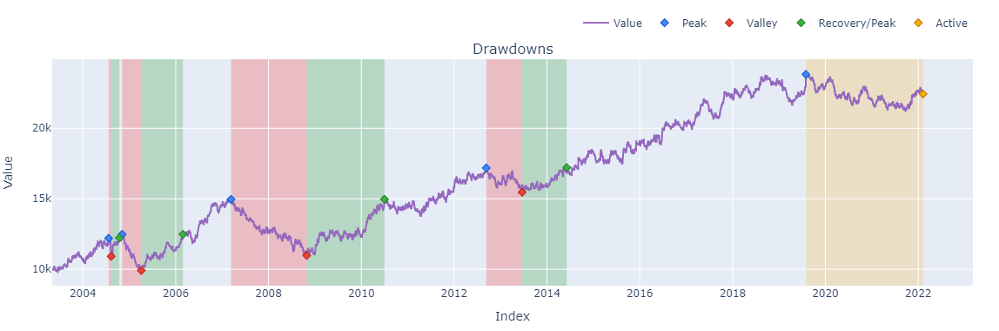

In [44]:
run_strategy_sl_fixRPT(df).plot(subplots=['drawdowns']).show() # Equity Curve

#### Trend Data 1

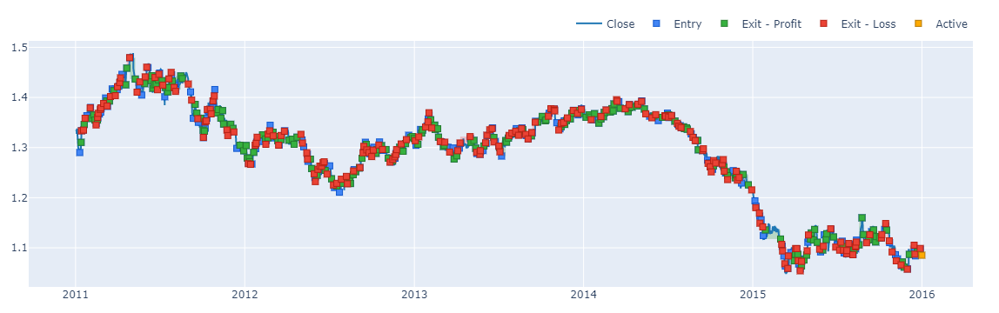

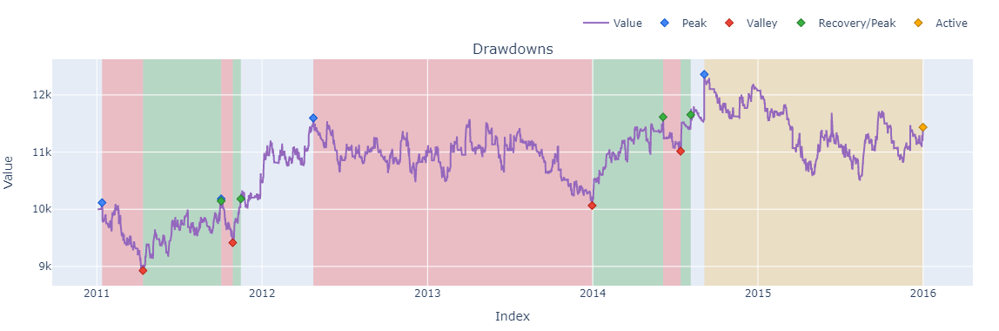

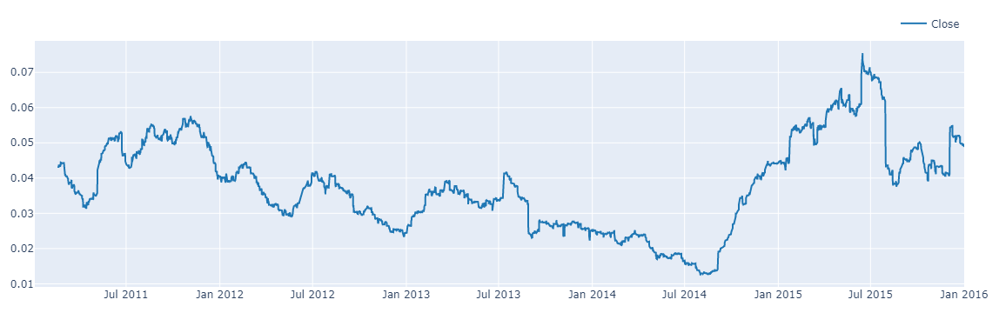

In [68]:
dftr1 = strategy(dftr1)
fig = dftr1.Close.vbt.plot(trace_kwargs=dict(name='Close'))
run_strategy_sl_fixRPT(dftr1).positions.plot(close_trace_kwargs=dict(visible=False), fig=fig)
fig.show()
run_strategy_sl_fixRPT(dftr1).plot(subplots=['drawdowns']).show()
(np.log(dftr1.Close/dftr1.Close.shift(1)).rolling(200).std()*252**.5).ewm(alpha=0.96).mean().vbt.plot().show() # Volatility

### Strategy test with Trend Period

####  Trend Data 2

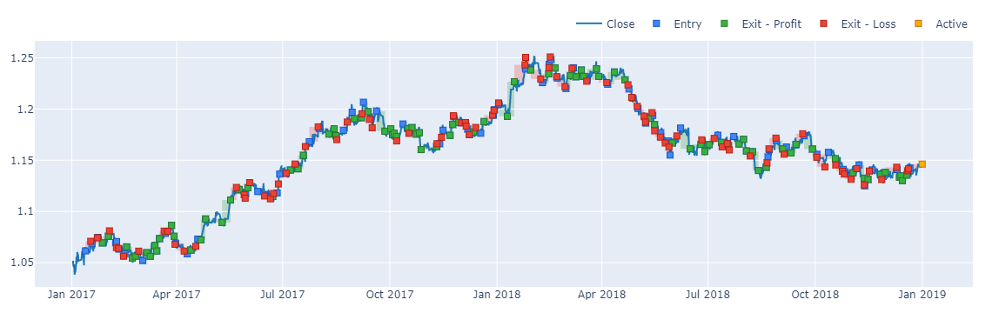

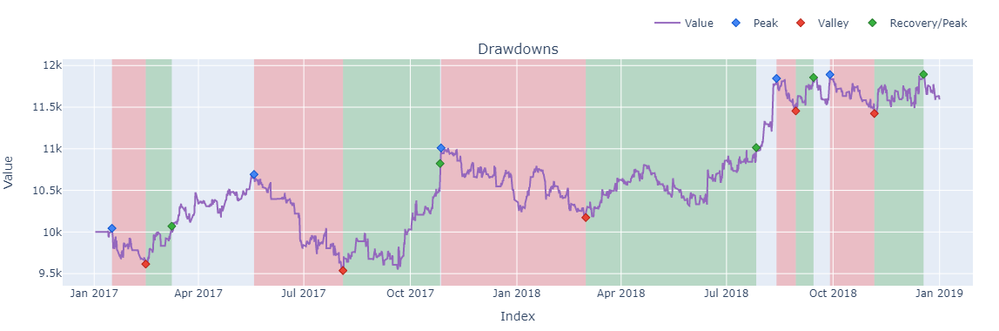

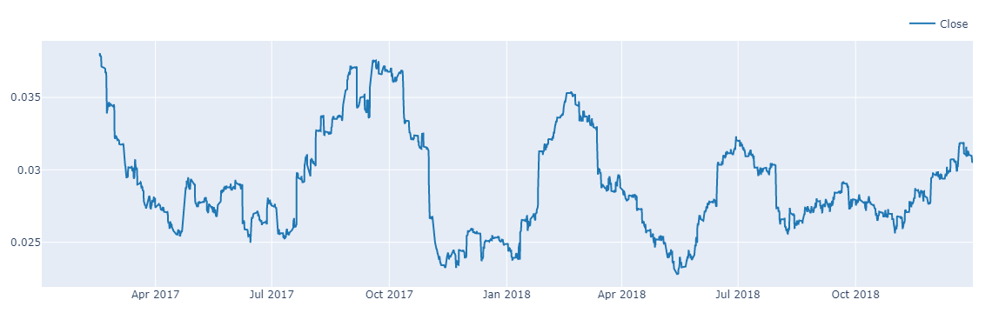

In [67]:
dftr2 = strategy(dftr2)
fig = dftr2.Close.vbt.plot(trace_kwargs=dict(name='Close'))
run_strategy_sl_fixRPT(dftr2).positions.plot(close_trace_kwargs=dict(visible=False), fig=fig)
fig.show()
run_strategy_sl_fixRPT(dftr2).plot(subplots=['drawdowns']).show()
(np.log(dftr2.Close/dftr2.Close.shift(1)).rolling(200).std()*252**.5).ewm(alpha=0.96).mean().vbt.plot().show() # Volatility

### Strategy test with non-Trend Period

####  Non-Trend Data 1

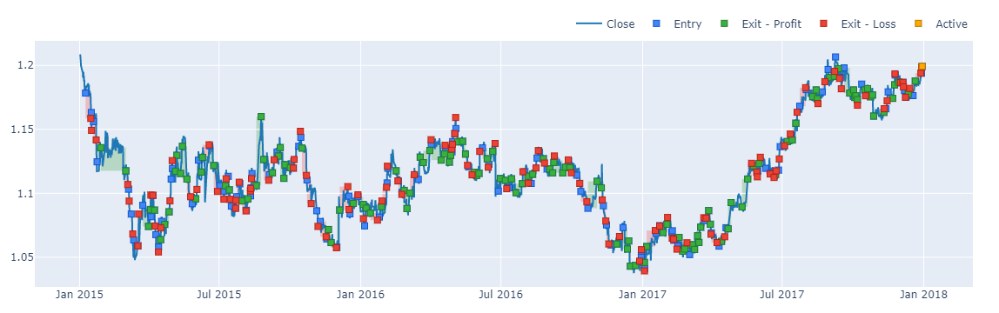

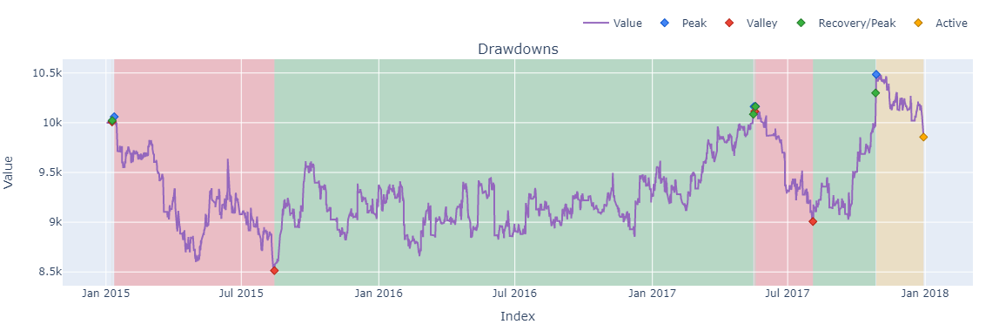

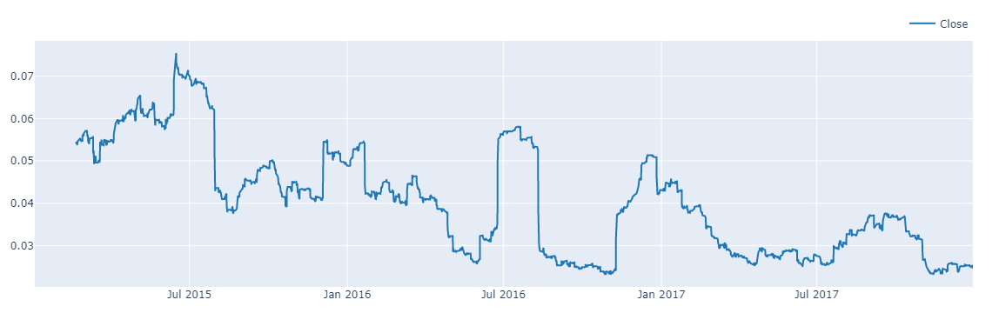

In [69]:
dfsw1 = strategy(dfsw1)
fig = dfsw1.Close.vbt.plot(trace_kwargs=dict(name='Close'))
run_strategy_sl_fixRPT(dfsw1).positions.plot(close_trace_kwargs=dict(visible=False), fig=fig)
fig.show()
run_strategy_sl_fixRPT(dfsw1).plot(subplots=['drawdowns']).show()
(np.log(dfsw1.Close/dfsw1.Close.shift(1)).rolling(200).std()*252**.5).ewm(alpha=0.96).mean().vbt.plot().show() # Volatility

####  Non-Trend Data 2

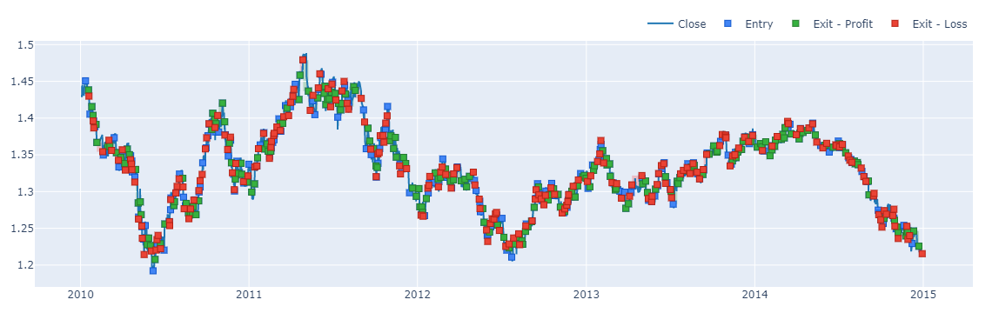

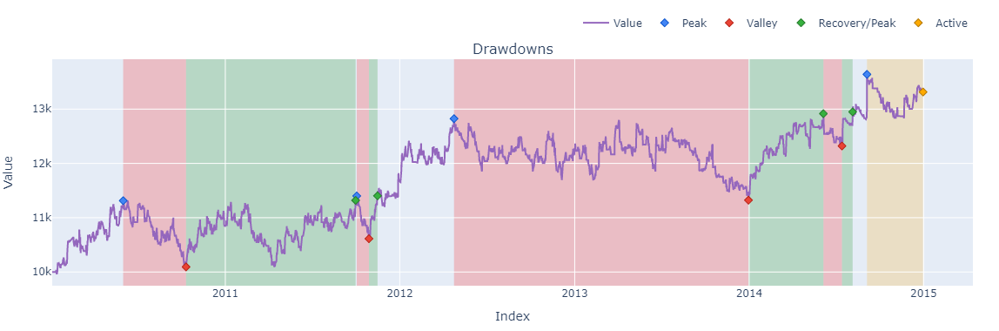

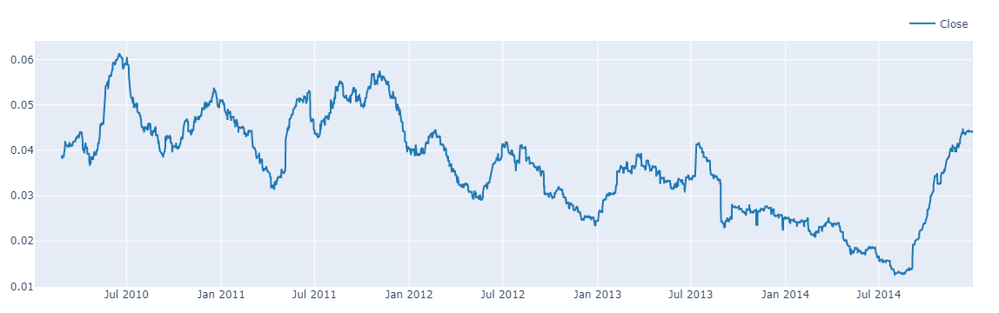

In [70]:
dfsw2 = strategy(dfsw2)
fig = dfsw2.Close.vbt.plot(trace_kwargs=dict(name='Close'))
run_strategy_sl_fixRPT(dfsw2).positions.plot(close_trace_kwargs=dict(visible=False), fig=fig)
fig.show()
run_strategy_sl_fixRPT(dfsw2).plot(subplots=['drawdowns']).show()
(np.log(dfsw2.Close/dfsw2.Close.shift(1)).rolling(200).std()*252**.5).ewm(alpha=0.96).mean().vbt.plot().show() # Volatility

### Parameter Optimization

In [56]:
portstats = []
param = []
array1 = np.arange(2, 100, 1)
for i in array1:
        
    df = strategy(df, length=i)

    #add to Empty Dataframe
    LongEntries = df.long_signal
    LongExit = df.long_exit      
    ShortEntries = df.short_signal
    ShortExit = df.short_exit

    df['vol'] = df.ta.stdev().ewm(alpha=0.96).mean()
    df['sl_stop'] = (df['vol'] * 1.2) / df.Close
    df['size'] = ((0.01 * 10000)/df['sl_stop'])/ df.Close
    port = vbt.Portfolio.from_signals(df.Close,
                                entries = df['long_signal'],
                                exits = df['long_exit'] ,
                                short_entries = df['short_signal'],
                                short_exits = df['short_exit'],
                                freq = '1h',
                                init_cash = 10000, size = df['size'],
                                fees = 0.00, sl_stop = df['sl_stop'],
                                slippage = 0.00) 
        
    paramm = pd.DataFrame({'array1': [i]})
    param.append(paramm)
    portstats.append(port.stats())  
        
statsdata = pd.DataFrame(portstats).dropna()    
statsdata.sort_values('Sharpe Ratio',ascending=False).head(3) # Top 3 best Parameter 

,Start,End,Period,Start Value,End Value,Total Return [%],Benchmark Return [%],Max Gross Exposure [%],Total Fees Paid,Max Drawdown [%],...,Avg Winning Trade [%],Avg Losing Trade [%],Avg Winning Trade Duration,Avg Losing Trade Duration,Profit Factor,Expectancy,Sharpe Ratio,Calmar Ratio,Omega Ratio,Sortino Ratio
7,2003-05-05,2022-02-07 20:00:00,1262 days,10000.0,22435.503756,124.355038,2.004244,3352.286805,0.0,26.626770,...,0.791212,-0.679775,0 days 18:12:15.766423357,0 days 11:45:32.219570405,1.128225,7.416574,1.167524,0.988771,1.045825,1.678960
8,2003-05-05,2022-02-07 20:00:00,1262 days,10000.0,17361.909717,73.619097,2.004244,3370.437912,0.0,28.316757,...,0.790786,-0.670061,0 days 18:00:40.248447204,0 days 11:46:05.339578454,1.077423,4.367305,0.776954,0.610938,1.030520,1.111452
9,2003-05-05,2022-02-07 20:00:00,1262 days,10000.0,15261.605947,52.616059,2.004244,60955.719127,0.0,36.806072,...,0.790596,-0.674539,0 days 18:26:33.516209476,0 days 11:32:43.255813953,1.056319,3.098099,0.590136,0.353366,1.023053,0.836982


In [57]:
param[7] # Best Parameter with higher Sharpe Ratio

,array1
0,9


### Final

In [117]:
def strategy(df, length= 9):
    df['f1'] = df.ta.fisher(length)[f"FISHERT_{length}_1"]
    df['f2'] = df.ta.fisher(length)[f"FISHERTs_{length}_1"]
    l1 = (df['f1'] > df['f2']) 
    l2 = (df['f1'] < (-1.45))
    df['long_signal'] = l1 & l2 

    s1 = (df['f1'] < df['f2'])
    s2 = (df['f1'] > (1.45))
    df['short_signal'] = s1 & s2 

    df['long_exit'] = s1 & s2
    df['short_exit'] = l1 & l2

    return df

df = strategy(df, 9)
#add to Empty Dataframe
LongEntries = df.long_signal
LongExit = df.long_exit      
ShortEntries = df.short_signal
ShortExit = df.short_exit

df['vol'] = df.ta.stdev().ewm(alpha=0.96).mean()
df['sl_stop'] = (df['vol'] * 1.2) / df.Close
df['size'] = ((0.01 * 10000)/df['sl_stop'])/ df.Close
port = vbt.Portfolio.from_signals(df.Close,
                            entries = df['long_signal'],
                            exits = df['long_exit'] ,
                            short_entries = df['short_signal'],
                            short_exits = df['short_exit'],
                            freq = '1h',
                            init_cash = 10000, size = df['size'],
                            fees = 0.00, sl_stop = df['sl_stop'],
                            slippage = 0.00)
port.stats()

Start                               2003-05-05 00:00:00
End                                 2022-02-07 20:00:00
Period                               1262 days 00:00:00
Start Value                                     10000.0
End Value                                  22435.503756
Total Return [%]                             124.355038
Benchmark Return [%]                           2.004244
Max Gross Exposure [%]                      3352.286805
Total Fees Paid                                     0.0
Max Drawdown [%]                               26.62677
Max Drawdown Duration                 222 days 21:00:00
Total Trades                                       1662
Total Closed Trades                                1661
Total Open Trades                                     1
Open Trade PnL                                 0.852081
Win Rate [%]                                   49.48826
Best Trade [%]                                 5.016153
Worst Trade [%]                               -2

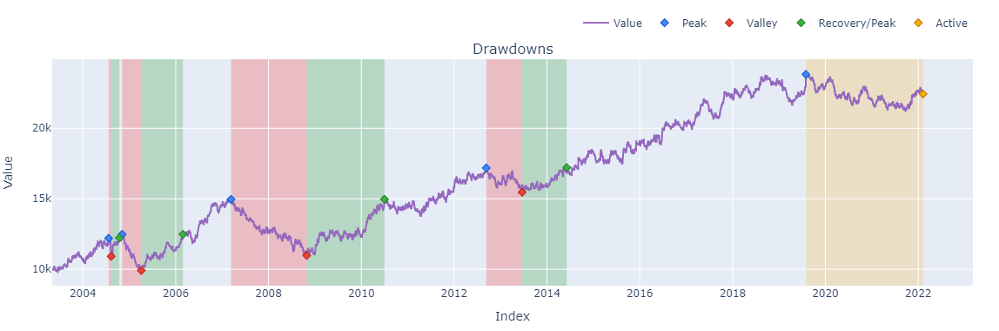

In [118]:
port.plot(subplots=['drawdowns']).show() # Equity Curve

In [71]:
portfinal = port.trades.records_readable
portfinal['PnL_pip'] = Cal_pip(portfinal)

In [72]:
print(f"Consecutive loss = {np.abs(cal_consecutive(portfinal['PnL']).min())}")
print(f"Consecutive win = {np.abs(cal_consecutive(portfinal['PnL']).max())}")

Consecutive loss = 11.0
Consecutive win = 9.0


In [73]:
Holding_period = (portfinal['Exit Timestamp'] - portfinal['Entry Timestamp']).apply(convert_to_hours).astype('int')
Holding_period.describe()

count    1662.000000
mean       80.584838
std        60.127056
min         4.000000
25%        36.000000
50%        68.000000
75%       112.000000
max       460.000000
dtype: float64

In [181]:
def hurst_exponent(df, max_lag=20):
    lags = range(2, max_lag)
    tau = [np.std(np.subtract(df.values[lag:], df.values[:-lag]),dtype=np.float64) for lag in lags]
    reg = np.polyfit(np.log(lags), np.log(tau), 1)
    return reg[0]

In [189]:

for lag in [20, 100, 300, 500, 1000]:
    hurst_exp = get_hurst_exponent(df["Close"].values, lag)
    print(f"Hurst exponent with {lag} lags: {hurst_exp:.4f}")

Hurst exponent with 20 lags: 0.4982
Hurst exponent with 100 lags: 0.4967
Hurst exponent with 300 lags: 0.5034
Hurst exponent with 500 lags: 0.5040
Hurst exponent with 1000 lags: 0.5171


### Research

In [74]:
portfinal = port.trades.records_readable
tradingdata = df.reset_index()
tradingdata = tradingdata[['Date', 'Open', 'High', 'Low', 'Close']]

In [75]:
tradingdata['_normPrice'] = (tradingdata.Close-tradingdata.Low)/(tradingdata.High-tradingdata.Low)
tradingdata['_avgreturn5'] = ta.sma(tradingdata.Close.pct_change(),5)
tradingdata['_avgreturn10'] = ta.sma(tradingdata.Close.pct_change(),10)
tradingdata['_avgreturn30'] = ta.sma(tradingdata.Close.pct_change(),30)
tradingdata['_avgreturn60'] = ta.sma(tradingdata.Close.pct_change(),60)
tradingdata['_rsi5'] = ta.rsi(tradingdata['Close'],5)
tradingdata['_rsi7'] = ta.rsi(tradingdata['Close'],7)
tradingdata['_rsi14'] = ta.rsi(tradingdata['Close'],14)
tradingdata['_rsi30'] = ta.rsi(tradingdata['Close'],30)
tradingdata['_rsi60'] = ta.rsi(tradingdata['Close'],60)
tradingdata['_slope3'] = tradingdata.ta.slope(3)
tradingdata['_slope5'] = tradingdata.ta.slope(5)
tradingdata['_slope10'] = tradingdata.ta.slope(10)
tradingdata['_slope20'] = tradingdata.ta.slope(20)
tradingdata['_macd12_26'] = tradingdata.ta.macd(12,26)['MACDh_12_26_9']
tradingdata['_macd10_30'] = tradingdata.ta.macd(10,30)['MACDh_10_30_9']
tradingdata['_macd5_10'] = tradingdata.ta.macd(5,10)['MACDh_5_10_9']
tradingdata['_macd2_10'] = tradingdata.ta.macd(2,10)['MACDh_2_10_9']
tradingdata['_macd12_26_change'] = tradingdata.ta.macd(12,26)['MACDh_12_26_9'].pct_change()
tradingdata['_macd10_30_change'] = tradingdata.ta.macd(10,30)['MACDh_10_30_9'].pct_change()
tradingdata['_macd5_10_change'] = tradingdata.ta.macd(5,10)['MACDh_5_10_9'].pct_change()
tradingdata['_macd2_10_change'] = tradingdata.ta.macd(2,10)['MACDh_2_10_9'].pct_change()
tradingdata['_avgema2_price'] = tradingdata.ta.ema(2)/tradingdata.Close
tradingdata['_avgema10_price'] = tradingdata.ta.ema(10)/tradingdata.Close
tradingdata['_avgema20_price'] = tradingdata.ta.ema(20)/tradingdata.Close
tradingdata['_avgema50_price'] = tradingdata.ta.ema(50)/tradingdata.Close
tradingdata['BBwid'] = tradingdata.ta.bbands()['BBU_5_2.0'] - tradingdata.ta.bbands()['BBL_5_2.0']
tradingdata['_adx'] = ta.adx(tradingdata['High'],tradingdata['Low'],tradingdata['Close']).iloc[:,:1]
tradingdata['_stochK'] = ta.stoch(tradingdata['High'], tradingdata['Low'], tradingdata['Close']).iloc[:,:1]
tradingdata['_natr'] = ta.natr(tradingdata['High'], tradingdata['Low'], tradingdata['Close'])
tradingdata['_stdev'] = ta.stdev(tradingdata['Close'])
tradingdata['_truerange'] =  ta.true_range(tradingdata['High'], tradingdata['Low'], tradingdata['Close'])
tradingdata['_stdev'] = ta.stdev(tradingdata['Close'])

In [76]:
full_position_data = tradingdata.merge(portfinal, left_on = 'Date', right_on = 'Entry Timestamp')
full_position_data.dropna(inplace = True)

##### only long position

In [77]:
full_position_data = full_position_data[full_position_data['Direction'] == 'Long']

In [78]:
# class count
full_position_data['target'] = np.where(full_position_data['Return'] > 0, 1, 0)
class_count_0, class_count_1 = full_position_data['target'].value_counts()

class_0 = full_position_data[full_position_data['target'] == 0]
class_1 = full_position_data[full_position_data['target'] == 1]
print('class 0:', class_0.shape)
print('class 1:', class_1.shape)

class 0: (384, 52)
class 1: (413, 52)


In [79]:
class_1_sample = class_1.sample(384)
class_0_sample = class_0.sample(384)
mldata = pd.concat([class_1_sample, class_0_sample], axis=0)
mldata['target'].value_counts()

1    384
0    384
Name: target, dtype: int64

In [80]:
cols = ['_normPrice', '_avgreturn5',
       '_avgreturn10', '_avgreturn30', '_avgreturn60', '_rsi5', '_rsi7',
       '_rsi14', '_rsi30', '_rsi60', '_slope3', '_slope5', '_slope10',
       '_slope20', '_macd12_26', '_macd10_30', '_macd5_10', '_macd2_10',
       '_macd12_26_change', '_macd10_30_change', '_macd5_10_change',
       '_macd2_10_change', '_avgema2_price', '_avgema10_price',
       '_avgema20_price', '_avgema50_price', 'BBwid', '_adx', '_stochK',
       '_natr', '_stdev', '_truerange']
X = mldata[cols]
y = mldata['target']

<AxesSubplot:xlabel='target', ylabel='_macd2_10_change'>

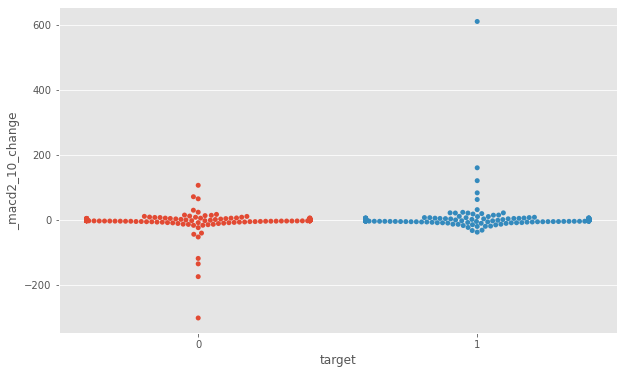

In [113]:
plt.figure(figsize=(10, 6))
sns.swarmplot(data = mldata, x = 'target', y='_macd2_10_change')

In [82]:
import pingouin as pg
for i in cols:
    a = mldata[mldata.target ==1][i].reset_index(drop=True)
    b = mldata[mldata.target ==0][i].reset_index(drop=True)
    print(i)
    print(pg.ttest(a, b).iloc[:,:7])

_normPrice
               T  dof alternative     p-val          CI95%   cohen-d   BF10
T-test  0.109199  766   two-sided  0.913073  [-0.03, 0.04]  0.007881  0.081
_avgreturn5
               T  dof alternative     p-val        CI95%   cohen-d  BF10
T-test  1.234305  766   two-sided  0.217468  [-0.0, 0.0]  0.089078  0.17
_avgreturn10
               T  dof alternative     p-val        CI95%   cohen-d   BF10
T-test  0.107083  766   two-sided  0.914751  [-0.0, 0.0]  0.007728  0.081
_avgreturn30
               T  dof alternative     p-val        CI95%   cohen-d   BF10
T-test -1.042431  766   two-sided  0.297541  [-0.0, 0.0]  0.075231  0.137
_avgreturn60
               T  dof alternative     p-val        CI95%   cohen-d   BF10
T-test -1.629552  766   two-sided  0.103607  [-0.0, 0.0]  0.117603  0.296
_rsi5
               T  dof alternative     p-val          CI95%   cohen-d   BF10
T-test  1.010843  766   two-sided  0.312411  [-0.95, 2.96]  0.072951  0.133
_rsi7
               T  dof alternativ